In [1]:
# Bibliothèques de base pour le traitement de données
import pandas as pd              # Pour charger et manipuler les données sous forme de DataFrame
import numpy as np               # Pour les opérations numériques et les fonctions mathématiques
import random 

# Bibliothèques pour la visualisation des données
import matplotlib.pyplot as plt  # Pour tracer des graphiques simples
import seaborn as sns            # Pour des graphiques plus sophistiqués et esthétiques

# Pour travailler avec les dates et heures
from datetime import datetime    # Pour manipuler les données de date et heure

In [2]:
# Lire le fichier CSV avec le bon délimiteur
file_path = r'swm_trialA_clean.csv'
df = pd.read_csv(file_path, sep=';')  # Utiliser `sep=';'` pour délimiter correctement les colonnes

# Afficher les premières lignes pour vérifier que les colonnes sont bien séparées
print(df.head())

# Extraire le nombre de lignes et de colonnes
nb_lignes, nb_colonnes = df.shape

# Afficher le résultat
print(f"Nombre de lignes : {nb_lignes}")
print(f"Nombre de colonnes : {nb_colonnes}")

# Afficher les noms des colonnes
print(f"Les noms des colonnes sont : {df.columns}")


                               user.key             datetime  meter.reading  \
0  1f8730a9-5d67-4895-9215-6e247087ea00  01/03/2016 01:19:43        68321.0   
1  1f8730a9-5d67-4895-9215-6e247087ea00  01/03/2016 02:19:43        68321.0   
2  1f8730a9-5d67-4895-9215-6e247087ea00  01/03/2016 03:19:43        68321.0   
3  1f8730a9-5d67-4895-9215-6e247087ea00  01/03/2016 04:19:43        68321.0   
4  1f8730a9-5d67-4895-9215-6e247087ea00  01/03/2016 05:39:54        68321.0   

   diff  
0     0  
1     0  
2     0  
3     0  
4     0  
Nombre de lignes : 673927
Nombre de colonnes : 4
Les noms des colonnes sont : Index(['user.key', 'datetime', 'meter.reading', 'diff'], dtype='object')


In [3]:
print(df.dtypes)

user.key          object
datetime          object
meter.reading    float64
diff               int64
dtype: object


In [4]:
print(df.isnull().sum())

user.key         0
datetime         0
meter.reading    0
diff             0
dtype: int64


In [5]:
print(df.describe())

       meter.reading           diff
count   6.739270e+05  673927.000000
mean    2.447163e+05      11.453898
std     1.761938e+05     860.816375
min     4.685000e+03 -248520.000000
25%     1.181595e+05       0.000000
50%     2.041580e+05       0.000000
75%     3.236760e+05      10.000000
max     1.109253e+06  248541.000000


In [6]:
# Compter le nombre d'utilisateurs uniques
users = df['user.key'].unique()
num_users = len(users)

print(f"Nombre d'utilisateurs uniques : {num_users}")


Nombre d'utilisateurs uniques : 92


In [7]:
# Remplacez 'datetime_column_name' par le nom réel de votre colonne datetime
df['datetime'] = pd.to_datetime(df['datetime'], format='%d/%m/%Y %H:%M:%S')

# Créer les colonnes 'Date' et 'Time' en séparant la colonne 'datetime'
df['Date'] = df['datetime'].dt.date
df['Time'] = df['datetime'].dt.time

# Afficher le DataFrame modifié
print("\nDataFrame avec les colonnes Date et Time :")
print(df.head())


DataFrame avec les colonnes Date et Time :
                               user.key            datetime  meter.reading  \
0  1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 01:19:43        68321.0   
1  1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 02:19:43        68321.0   
2  1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 03:19:43        68321.0   
3  1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 04:19:43        68321.0   
4  1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 05:39:54        68321.0   

   diff        Date      Time  
0     0  2016-03-01  01:19:43  
1     0  2016-03-01  02:19:43  
2     0  2016-03-01  03:19:43  
3     0  2016-03-01  04:19:43  
4     0  2016-03-01  05:39:54  


In [8]:
print(df.dtypes)


user.key                 object
datetime         datetime64[ns]
meter.reading           float64
diff                      int64
Date                     object
Time                     object
dtype: object


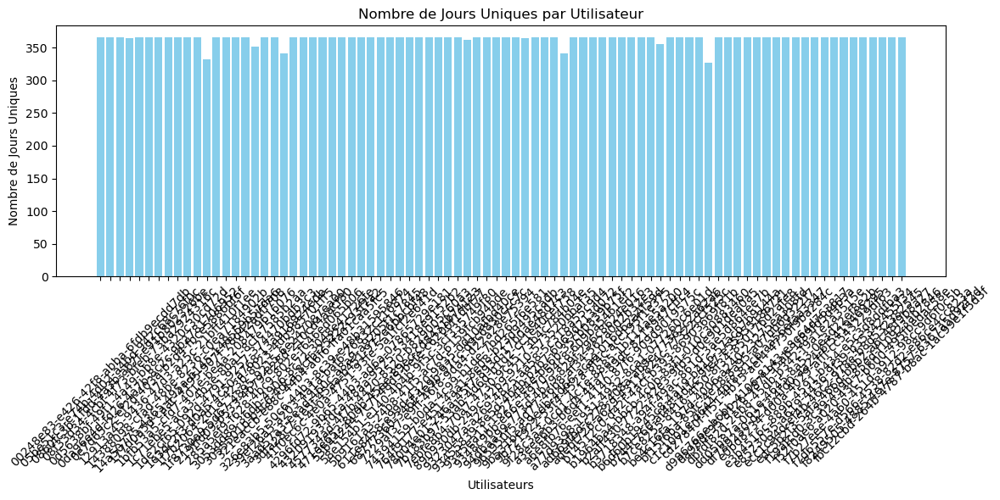

In [12]:
# Compter le nombre de jours uniques par utilisateur
daily_counts = df.groupby('user.key')['Date'].nunique().reset_index()

# Renommer les colonnes pour plus de clarté
daily_counts.columns = ['User', 'Number of Unique Days']

# Tracer le graphique à barres
plt.figure(figsize=(12, 6))
plt.bar(daily_counts['User'], daily_counts['Number of Unique Days'], color='skyblue')
plt.xlabel('Utilisateurs')
plt.ylabel('Nombre de Jours Uniques')
plt.title('Nombre de Jours Uniques par Utilisateur')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [13]:
# Compter le nombre de jours uniques par utilisateur dans df_with_numbers
daily_counts = df.groupby('user.key')['Date'].nunique().reset_index()
daily_counts.columns = ['User', 'Number of Unique Days']

# Filtrer pour garder seulement les utilisateurs avec 250 jours uniques ou plus
filtered_daily_counts = daily_counts[daily_counts['Number of Unique Days'] >= 300]

# Obtenir la liste des user_number à conserver
users_to_keep = filtered_daily_counts['User'].unique()

# Modifier le DataFrame df_with_numbers en place pour ne garder que ces utilisateurs
df = df[df['user.key'].isin(users_to_keep)]

# Afficher le DataFrame modifié
print(df)

# Optionnel : Afficher le nombre total d'utilisateurs restants
print(f'Nombre total d\'utilisateurs restants : {df["user.key"].nunique()}')

                                    user.key            datetime  \
0       1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 01:19:43   
1       1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 02:19:43   
2       1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 03:19:43   
3       1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 04:19:43   
4       1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 05:39:54   
...                                      ...                 ...   
673922  890930db-249c-42b9-9210-573520bbaf35 2017-02-28 18:08:01   
673923  890930db-249c-42b9-9210-573520bbaf35 2017-02-28 19:08:06   
673924  890930db-249c-42b9-9210-573520bbaf35 2017-02-28 20:08:06   
673925  890930db-249c-42b9-9210-573520bbaf35 2017-02-28 21:08:06   
673926  890930db-249c-42b9-9210-573520bbaf35 2017-02-28 22:08:06   

        meter.reading  diff        Date      Time  
0             68321.0     0  2016-03-01  01:19:43  
1             68321.0     0  2016-03-01  02:19:43  
2             68321.0     0

In [15]:
# Obtenir les utilisateurs uniques
unique_users = df['user.key'].unique()

# Créer un DataFrame avec les utilisateurs et un numéro séquentiel
user_mapping = pd.DataFrame({
    'user.key': unique_users,
    'user_number': range(1, len(unique_users) + 1)  # Créer une séquence de 1 à n
})

# Afficher le mapping
print(user_mapping)

# Fusionner ce DataFrame avec le DataFrame original pour associer les numéros
df_with_numbers = df.merge(user_mapping, on='user.key', how='left')

# Afficher le DataFrame avec les numéros associés
print(df_with_numbers)

# Afficher le nombre total de lignes et de colonnes
print(f'Nombre total de lignes : {len(df_with_numbers)}')
print(f'Nombre total de colonnes : {len(df_with_numbers.columns)}')

                                user.key  user_number
0   1f8730a9-5d67-4895-9215-6e247087ea00            1
1   d986766e-b6bb-4106-8143-e8c64d763817            2
2   df789230-d273-4fd0-aa24-6f5419469295            3
3   9f28c3a3-0cd1-4c1e-8885-1b114ae5a200            4
4   05be51c3-e74b-4d02-a4bd-942c68c76f0c            5
..                                   ...          ...
79  3dfa28c7-1e5f-45aa-b451-972e6bbcbf48           80
80  0d5638bf-49f1-4a49-bb8e-4320c30cd72d           81
81  68777360-346f-4e9b-97cc-d9c6830ccc7c           82
82  c1c1001e-d644-4bf8-81cb-aa56efaa3347           83
83  890930db-249c-42b9-9210-573520bbaf35           84

[84 rows x 2 columns]
                                    user.key            datetime  \
0       1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 01:19:43   
1       1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 02:19:43   
2       1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 03:19:43   
3       1f8730a9-5d67-4895-9215-6e247087ea00 2016-03-01 0

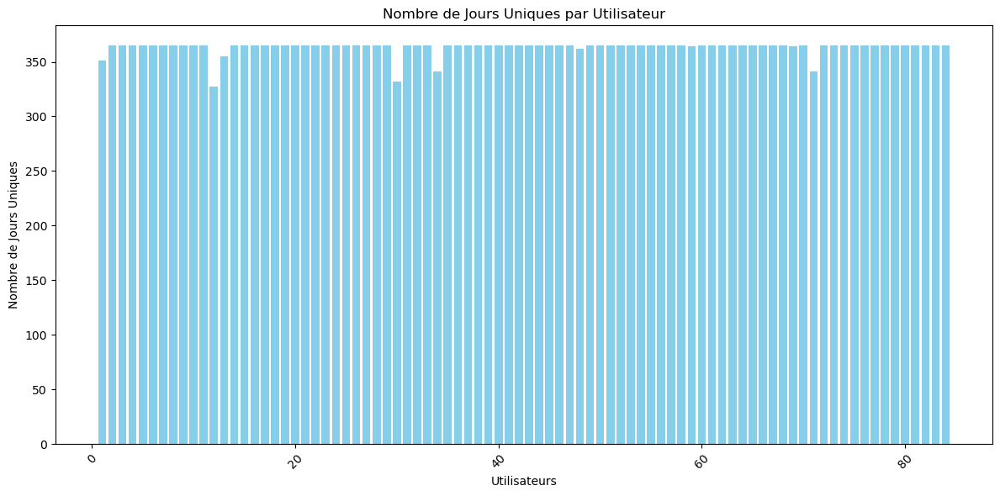

In [16]:
# Compter le nombre de jours uniques par utilisateur
daily_counts = df_with_numbers.groupby('user_number')['Date'].nunique().reset_index()

# Renommer les colonnes pour plus de clarté
daily_counts.columns = ['User', 'Number of Unique Days']

# Tracer le graphique à barres
plt.figure(figsize=(12, 6))
plt.bar(daily_counts['User'], daily_counts['Number of Unique Days'], color='skyblue')
plt.xlabel('Utilisateurs')
plt.ylabel('Nombre de Jours Uniques')
plt.title('Nombre de Jours Uniques par Utilisateur')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [17]:
df_with_numbers

,user.key,datetime,meter.reading,diff,Date,Time,user_number
0,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 01:19:43,68321.0,0,2016-03-01,01:19:43,1
1,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 02:19:43,68321.0,0,2016-03-01,02:19:43,1
2,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 03:19:43,68321.0,0,2016-03-01,03:19:43,1
3,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 04:19:43,68321.0,0,2016-03-01,04:19:43,1
4,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 05:39:54,68321.0,0,2016-03-01,05:39:54,1
...,...,...,...,...,...,...,...
661197,890930db-249c-42b9-9210-573520bbaf35,2017-02-28 18:08:01,284336.0,0,2017-02-28,18:08:01,84
661198,890930db-249c-42b9-9210-573520bbaf35,2017-02-28 19:08:06,284336.0,0,2017-02-28,19:08:06,84
661199,890930db-249c-42b9-9210-573520bbaf35,2017-02-28 20:08:06,284363.0,27,2017-02-28,20:08:06,84
661200,890930db-249c-42b9-9210-573520bbaf35,2017-02-28 21:08:06,284406.0,43,2017-02-28,21:08:06,84


----------------------------------------------------------Visualisation-------------------------------------------------------------

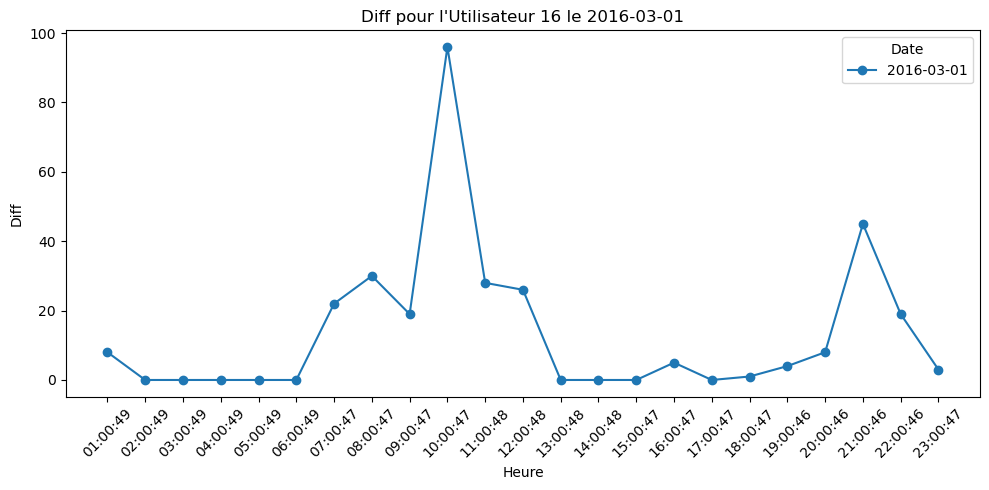

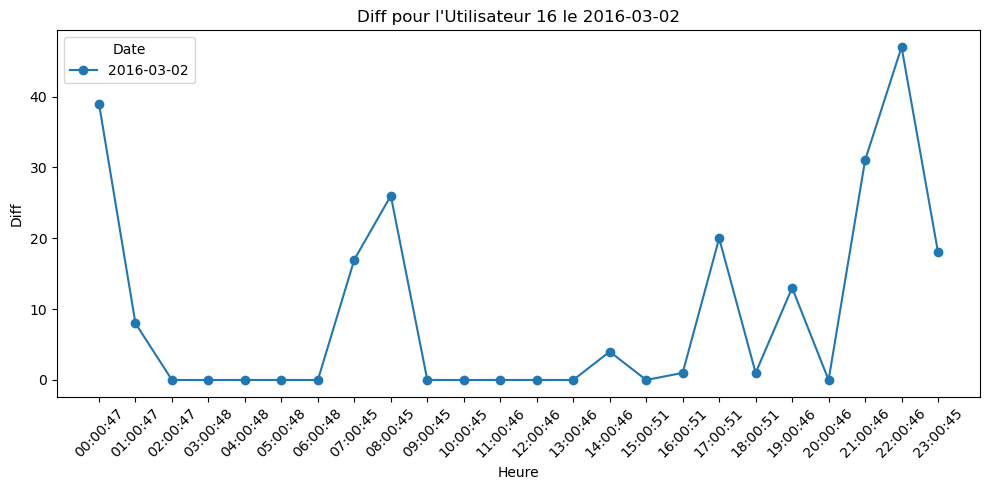

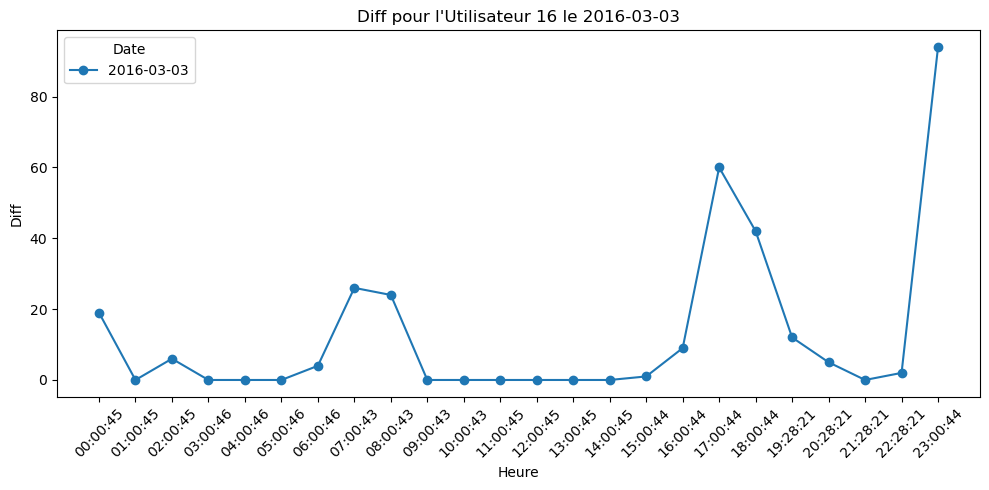

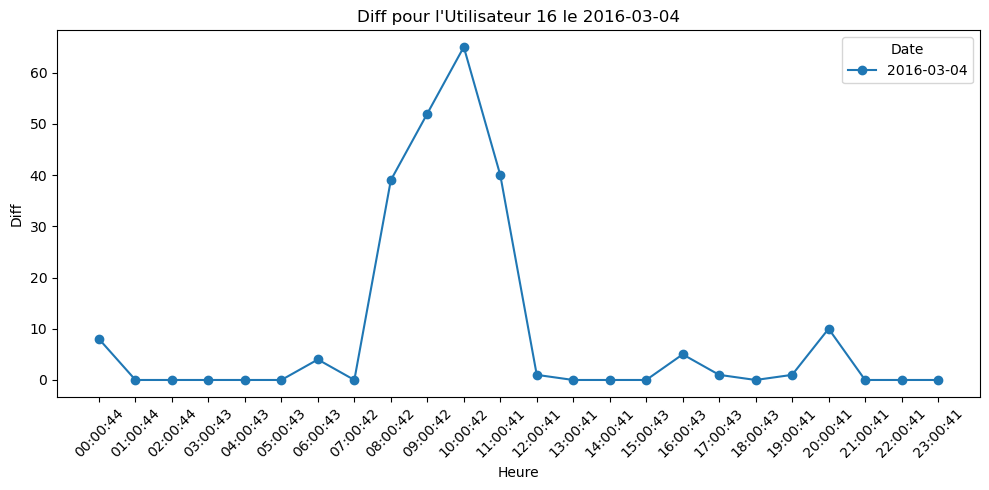

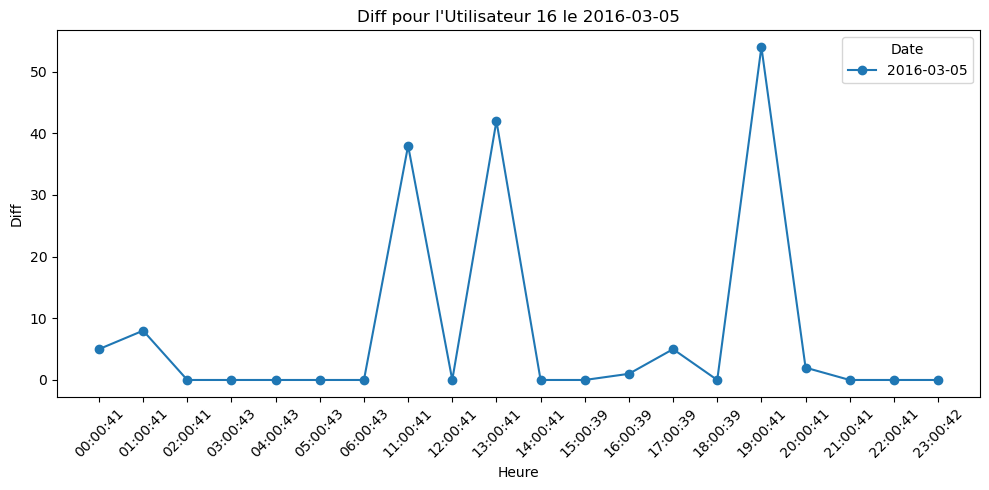

...

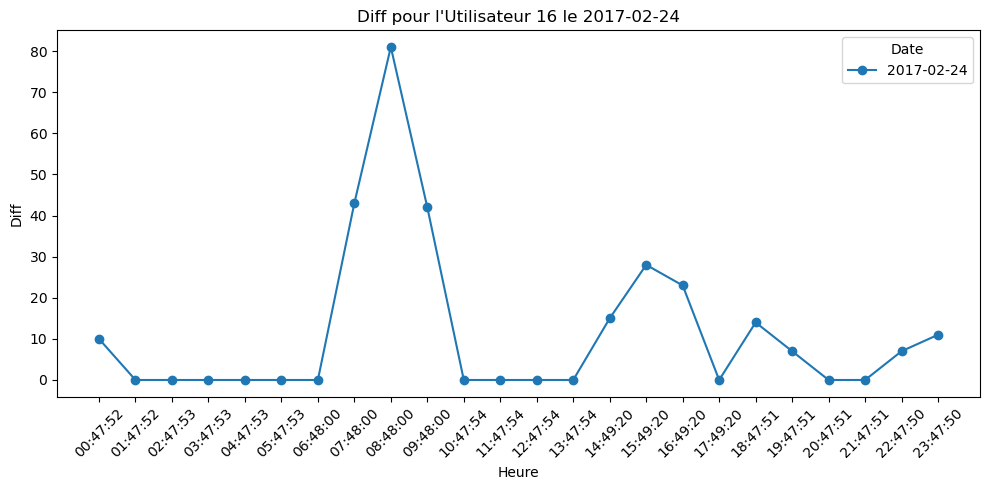

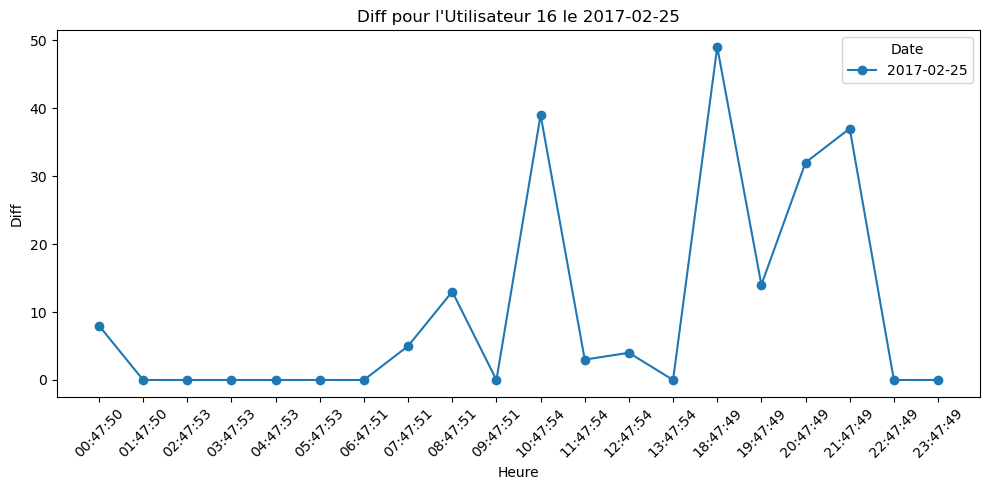

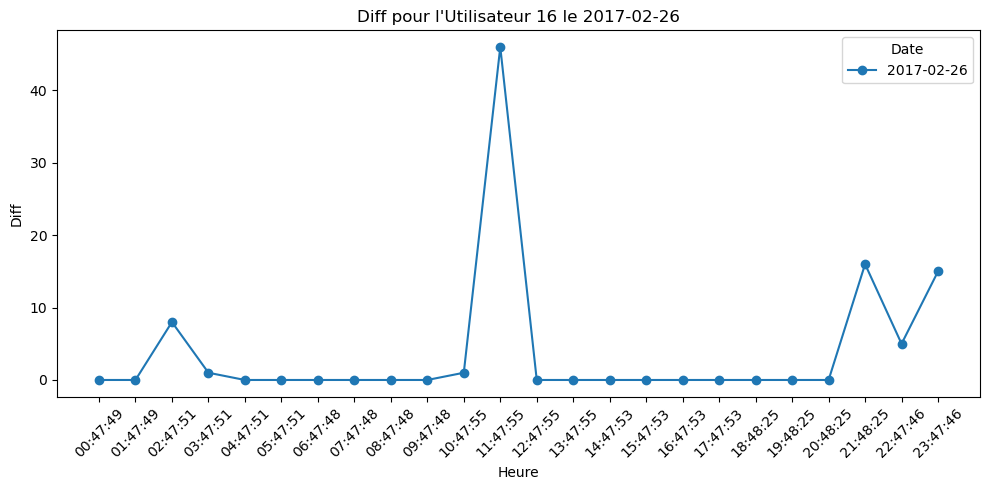

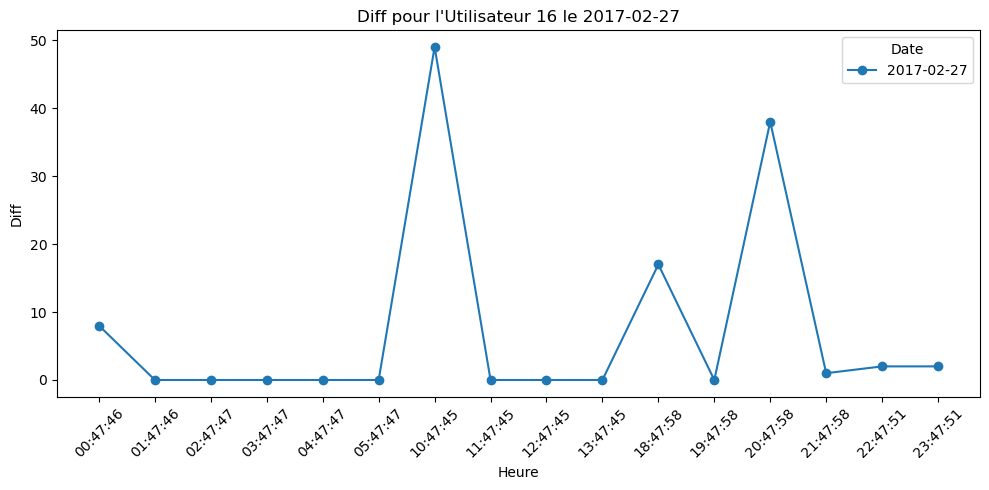

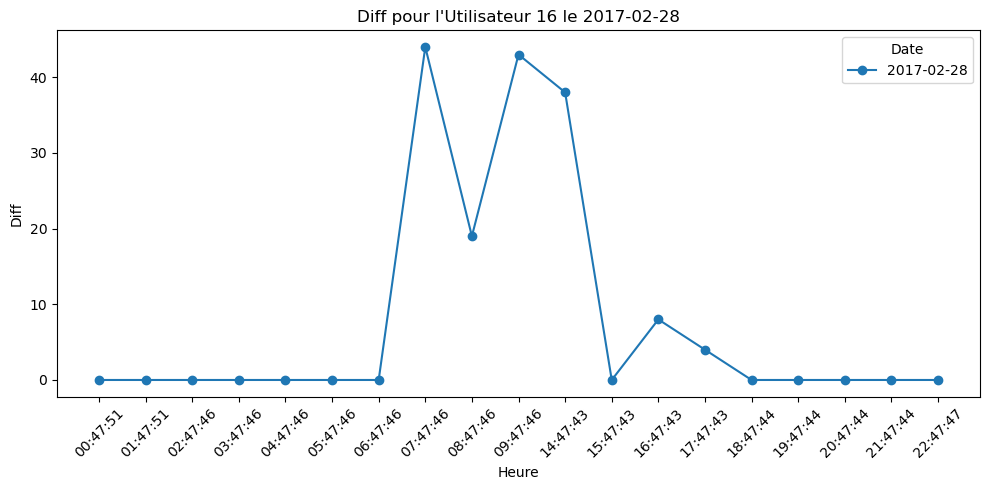

In [62]:
# Choisir un utilisateur aléatoire 
user_random = random.choice(df_with_numbers['user_number'].unique())

# Filtrer les données pour cet utilisateur
user_data = df_with_numbers[df_with_numbers['user_number'] == user_random]

# Obtenir toutes les dates uniques pour l'utilisateur
dates = user_data['Date'].unique()

for date in dates:
    # Filtrer les données quotidiennes pour chaque date
    daily_data = user_data[user_data['Date'] == date]

    # Créer une nouvelle figure pour chaque date
    plt.figure(figsize=(10, 5))  # Ajuster la taille de la figure

    # Tracer les points pour la date en question
    plt.plot(daily_data['Time'].astype(str), daily_data['diff'], marker='o', label=str(date))
    plt.ylabel('Diff')
    plt.title(f'Diff pour l\'Utilisateur {user_random} le {date}')
    plt.legend(title='Date')

    # Ajouter le label commun pour l'axe des x
    plt.xlabel('Heure')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()  # Afficher la figure pour cette date

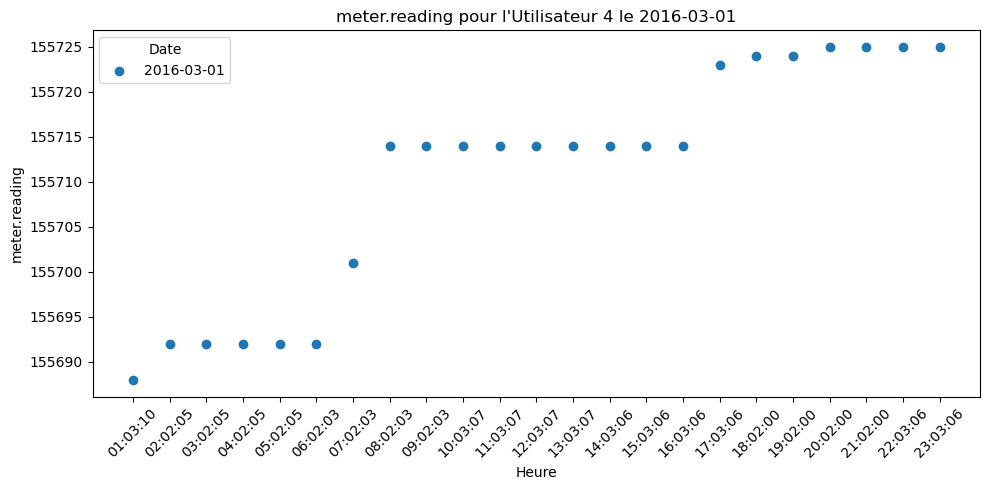

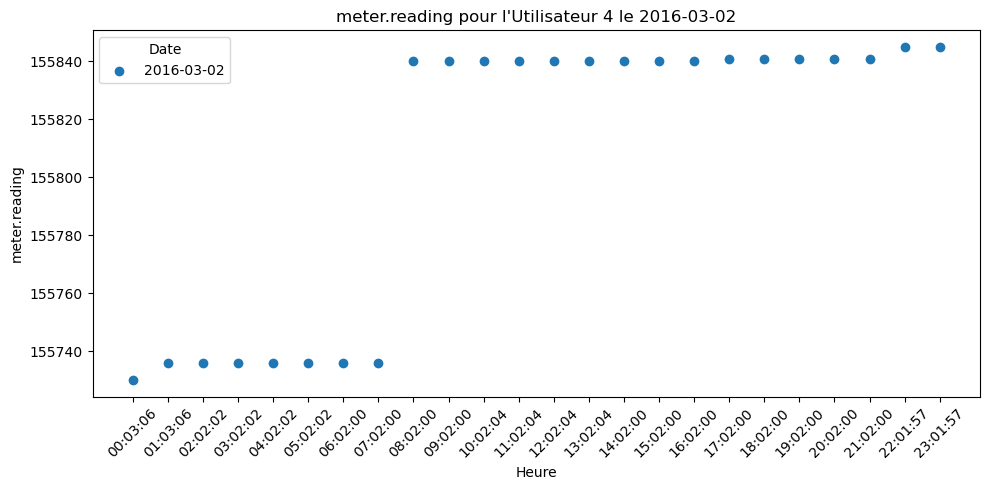

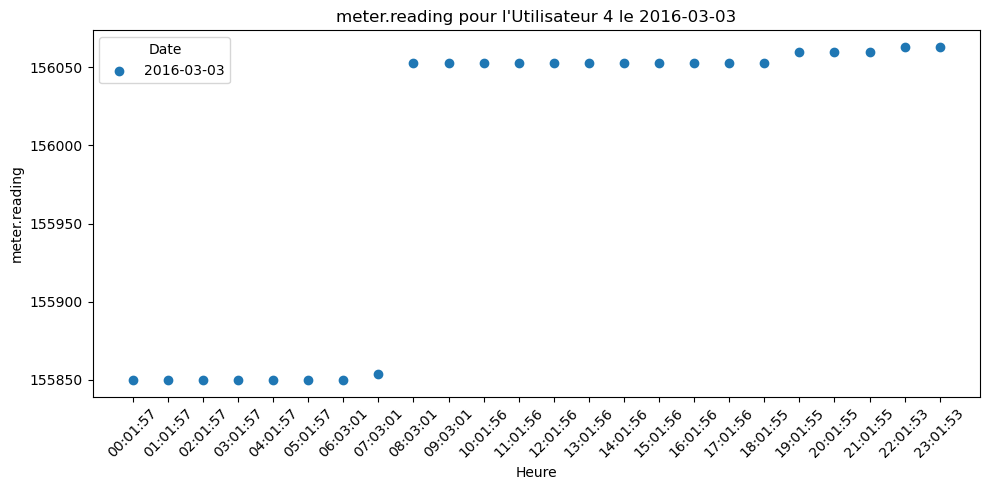

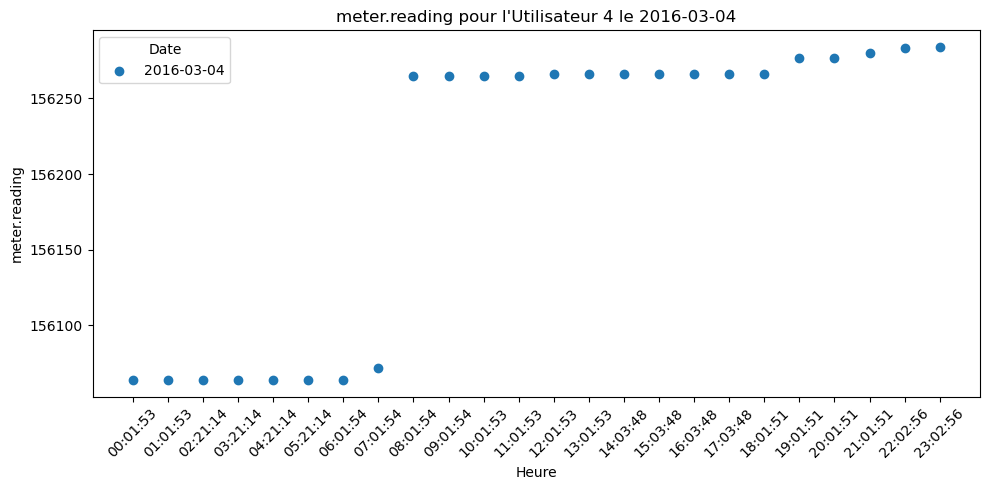

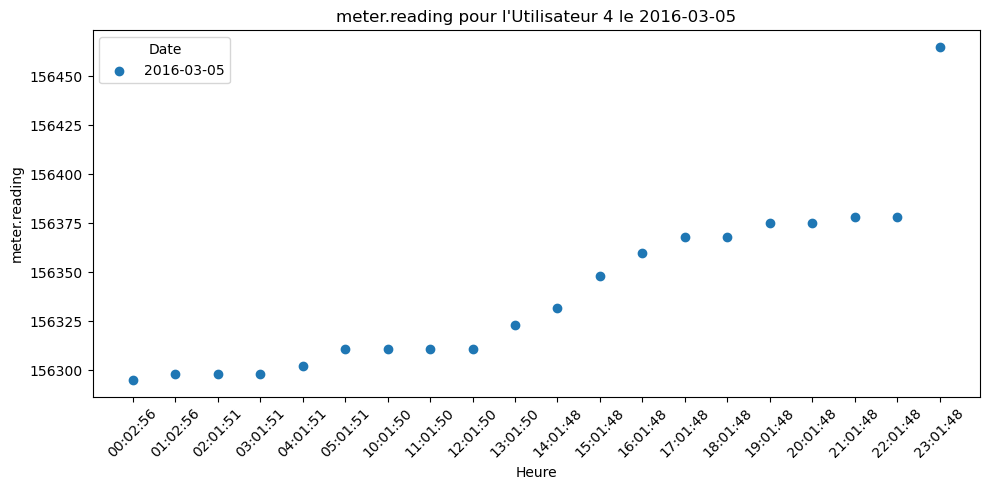

...

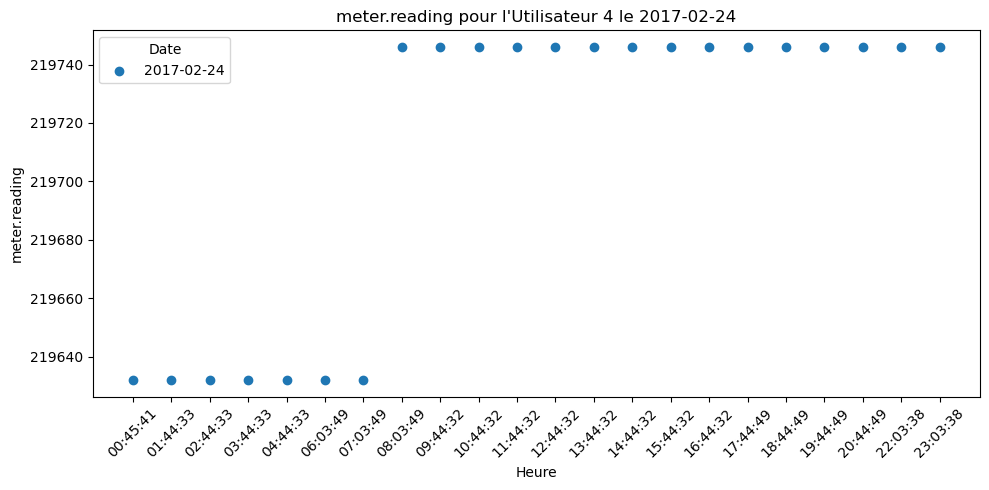

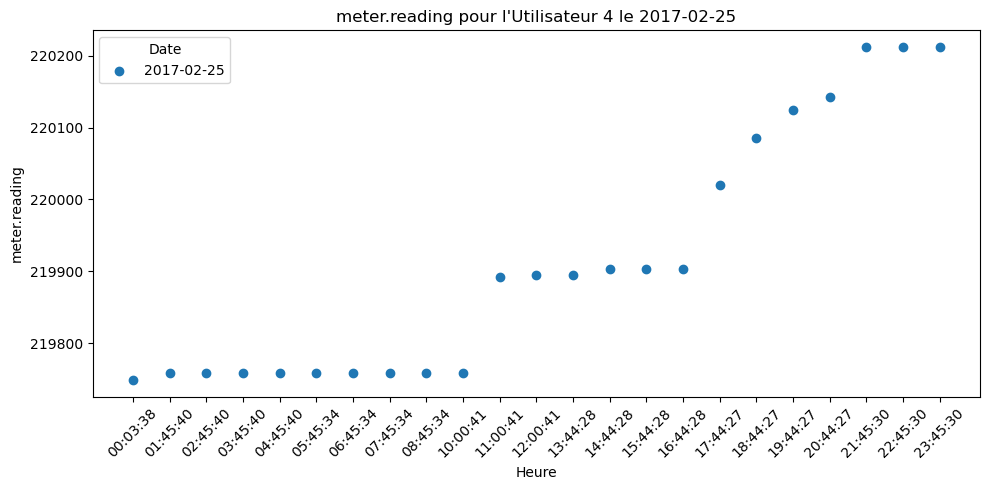

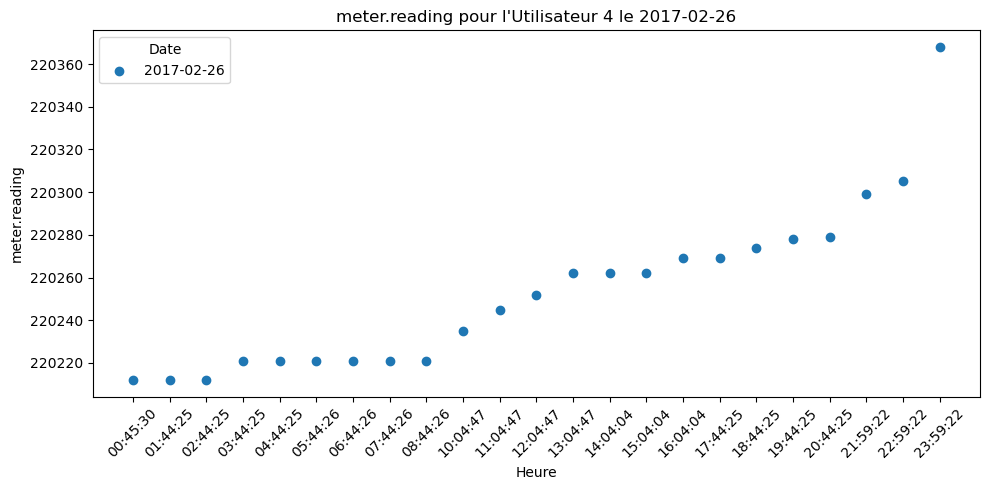

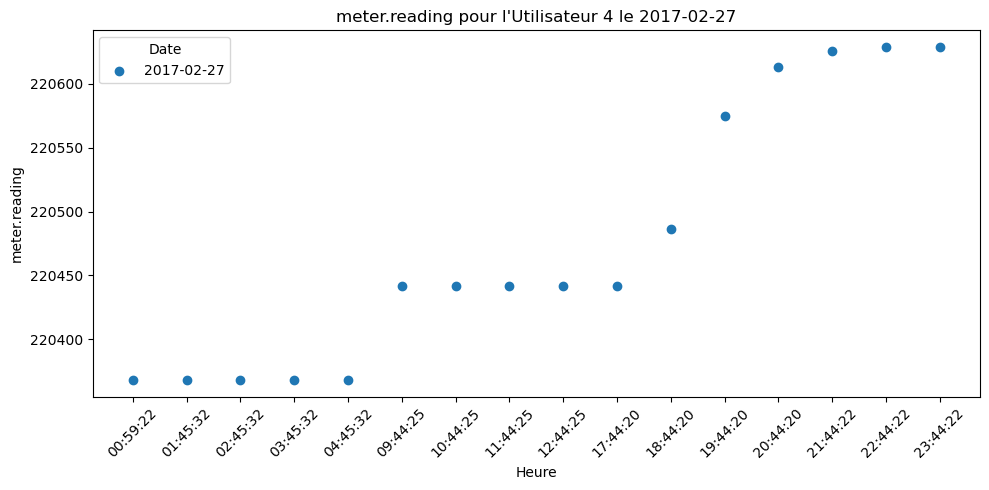

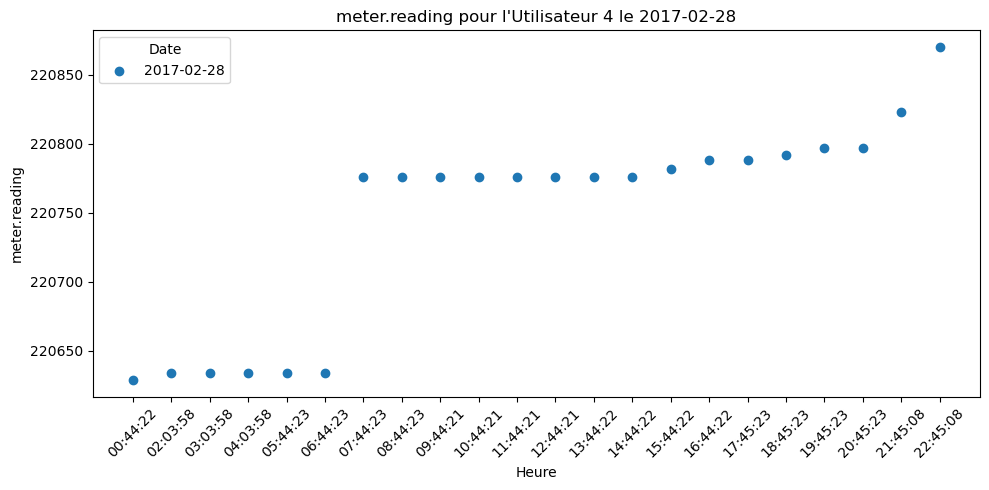

In [20]:
# Choisir un utilisateur aléatoire 
user_random = random.choice(df_with_numbers['user_number'].unique())

# Filtrer les données pour cet utilisateur
user_data = df_with_numbers[df_with_numbers['user_number'] == user_random]

# Obtenir toutes les dates uniques pour l'utilisateur
dates = user_data['Date'].unique()

for date in dates:
    # Filtrer les données quotidiennes pour chaque date
    daily_data = user_data[user_data['Date'] == date]

    # Créer une nouvelle figure pour chaque date
    plt.figure(figsize=(10, 5))  # Ajuster la taille de la figure

    # Tracer les points pour la date en question
    plt.scatter(daily_data['Time'].astype(str), daily_data['meter.reading'], marker='o', label=str(date))
    plt.ylabel('meter.reading')
    plt.title(f'meter.reading pour l\'Utilisateur {user_random} le {date}')
    plt.legend(title='Date')

    # Ajouter le label commun pour l'axe des x
    plt.xlabel('Heure')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()  # Afficher la figure pour cette date

C:\Users\MSI\AppData\Local\Temp\ipykernel_12860\2831317663.py:28: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


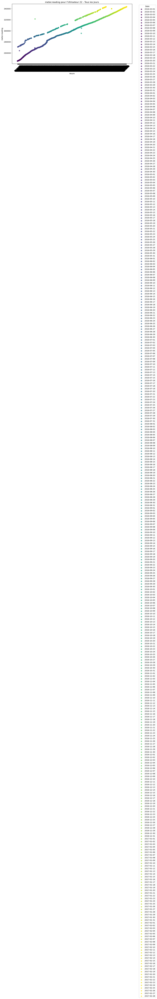

In [64]:
# Choisir un utilisateur aléatoire
user_random = random.choice(df_with_numbers['user_number'].unique())

# Filtrer les données pour cet utilisateur
user_data = df_with_numbers[df_with_numbers['user_number'] == user_random]

# Obtenir toutes les dates uniques pour l'utilisateur
dates = user_data['Date'].unique()

# Créer une nouvelle figure
plt.figure(figsize=(12, 6))

# Définir une palette de couleurs
colors = plt.cm.viridis(np.linspace(0, 1, len(dates)))  # Utiliser la palette Viridis

# Tracer les points pour chaque date
for i, date in enumerate(dates):
    daily_data = user_data[user_data['Date'] == date]
    plt.scatter(daily_data['Time'].astype(str), daily_data['meter.reading'], 
                color=colors[i], label=str(date), alpha=0.7)  # alpha pour la transparence

# Ajouter les labels et le titre
plt.ylabel('meter.reading')
plt.title(f'meter.reading pour l\'Utilisateur {user_random} - Tous les Jours')
plt.legend(title='Date', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xlabel('Heure')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()  # Afficher la figure pour toutes les dates

In [67]:
df_with_numbers

,user.key,datetime,meter.reading,diff,Date,Time,user_number,hour,time_interval,user_cluster
0,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 01:19:43,68321.0,0,2016-03-01,01:19:43,1,1,0-2h,3
1,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 02:19:43,68321.0,0,2016-03-01,02:19:43,1,2,2-4h,3
2,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 03:19:43,68321.0,0,2016-03-01,03:19:43,1,3,2-4h,3
3,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 04:19:43,68321.0,0,2016-03-01,04:19:43,1,4,4-6h,3
4,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 05:39:54,68321.0,0,2016-03-01,05:39:54,1,5,4-6h,3
...,...,...,...,...,...,...,...,...,...,...
661197,890930db-249c-42b9-9210-573520bbaf35,2017-02-28 18:08:01,284336.0,0,2017-02-28,18:08:01,84,18,18-21h,0
661198,890930db-249c-42b9-9210-573520bbaf35,2017-02-28 19:08:06,284336.0,0,2017-02-28,19:08:06,84,19,18-21h,0
661199,890930db-249c-42b9-9210-573520bbaf35,2017-02-28 20:08:06,284363.0,27,2017-02-28,20:08:06,84,20,18-21h,0
661200,890930db-249c-42b9-9210-573520bbaf35,2017-02-28 21:08:06,284406.0,43,2017-02-28,21:08:06,84,21,21-24h,0


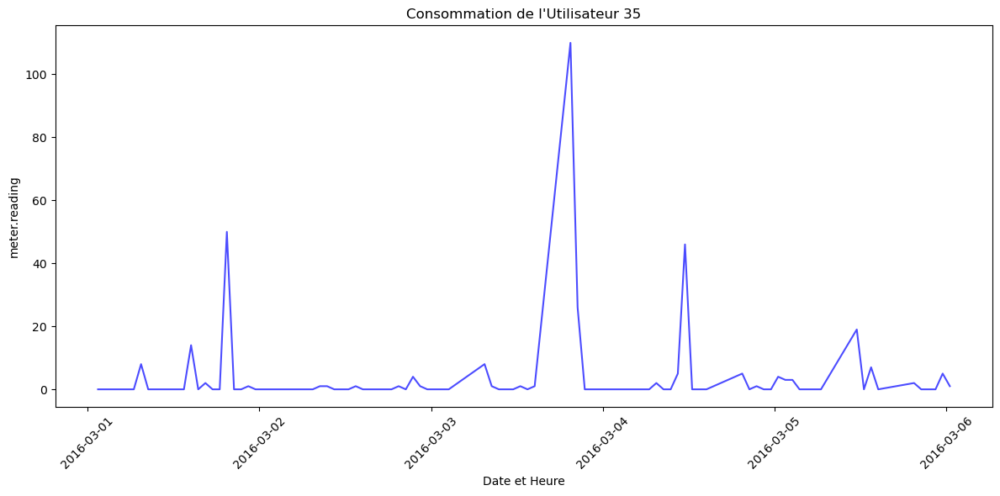

In [88]:
import numpy as np
import random
import matplotlib.pyplot as plt
import pandas as pd

# Choisir un utilisateur aléatoire
user_random = random.choice(df_with_numbers['user_number'].unique())

# Filtrer les données pour cet utilisateur
user_data = df_with_numbers[df_with_numbers['user_number'] == user_random]

# Créer une colonne `datetime` en combinant `Date` et `Time` si cela n'est pas déjà fait
if 'datetime' not in user_data.columns:
    user_data['datetime'] = pd.to_datetime(user_data['Date'] + ' ' + user_data['Time'].astype(str))

# Trier les données par `datetime`
user_data = user_data.sort_values(by='datetime')

# Filtrer les 500 premières entrées uniques de `datetime`
user_data_500_points = user_data.head(100)

# Créer une nouvelle figure
plt.figure(figsize=(12, 6))

# Tracer les lectures de compteur pour chaque point dans `datetime`
plt.plot(user_data_500_points['datetime'], user_data_500_points['diff'], 
         color='blue', alpha=0.7)

# Ajouter les étiquettes et le titre
plt.ylabel('meter.reading')
plt.title(f'Consommation de l\'Utilisateur {user_random}')
plt.xlabel('Date et Heure')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()  # Afficher le graphique


In [ ]:
from sklearn.cluster import KMeans

In [45]:
# Étape 1 : Prétraitement des données
df_with_numbers['datetime'] = pd.to_datetime(df_with_numbers['datetime'])  # Convertir en datetime
df_with_numbers['hour'] = df_with_numbers['datetime'].dt.hour  # Extraire l'heure
# Étape 2 : Création des intervalles de temps
# Définir les intervalles horaires
bins = [0, 2, 4, 6, 12, 18, 21, 23]  # Ajout de l'intervalle 2-4h
labels = ['0-2h', '2-4h', '4-6h', '6-12h', '12-18h', '18-21h', '21-24h']  # Mise à jour des étiquettes
df_with_numbers['time_interval'] = pd.cut(df_with_numbers['hour'], bins=bins, labels=labels, right=False)

In [58]:
# Étape 3 : Agrégation des données
# Calculer la moyenne des lectures de compteur par utilisateur et par intervalle de temps
aggregated_df = df_with_numbers.groupby(['user_number', 'time_interval'])['meter.reading'].mean().unstack(fill_value=0)

# Afficher le DataFrame agrégé
print("DataFrame agrégé :")
aggregated_df

DataFrame agrégé :


C:\Users\MSI\AppData\Local\Temp\ipykernel_12860\253345495.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  aggregated_df = df_with_numbers.groupby(['user_number', 'time_interval'])['meter.reading'].mean().unstack(fill_value=0)


time_interval,0-2h,2-4h,4-6h,6-12h,12-18h,18-21h,21-24h
user_number,,,,,,,
1,9.339429e+04,9.404092e+04,9.334419e+04,9.288926e+04,9.258867e+04,9.362960e+04,9.373105e+04
2,1.475378e+05,1.473633e+05,1.470288e+05,1.473244e+05,1.474212e+05,1.475189e+05,1.475966e+05
3,1.002284e+06,1.002369e+06,1.002589e+06,1.003136e+06,1.002812e+06,1.002098e+06,1.002435e+06
4,1.868638e+05,1.869756e+05,1.865898e+05,1.869528e+05,1.870816e+05,1.872200e+05,1.866324e+05
5,4.083059e+05,4.067537e+05,4.062393e+05,4.068016e+05,4.070430e+05,4.079639e+05,4.080462e+05
...,...,...,...,...,...,...,...
80,2.677294e+05,2.677735e+05,2.678823e+05,2.675481e+05,2.675129e+05,2.675592e+05,2.678409e+05
81,1.081714e+05,1.081689e+05,1.081686e+05,1.081687e+05,1.081670e+05,1.081746e+05,1.081714e+05
82,1.745637e+05,1.748069e+05,1.749437e+05,1.746902e+05,1.749768e+05,1.748583e+05,1.749157e+05


time_interval          0-2h          2-4h          4-6h         6-12h  \
user_number                                                             
1              9.339429e+04  9.404092e+04  9.334419e+04  9.288926e+04   
2              1.475378e+05  1.473633e+05  1.470288e+05  1.473244e+05   
3              1.002284e+06  1.002369e+06  1.002589e+06  1.003136e+06   
4              1.868638e+05  1.869756e+05  1.865898e+05  1.869528e+05   
5              4.083059e+05  4.067537e+05  4.062393e+05  4.068016e+05   
...                     ...           ...           ...           ...   
80             2.677294e+05  2.677735e+05  2.678823e+05  2.675481e+05   
81             1.081714e+05  1.081689e+05  1.081686e+05  1.081687e+05   
82             1.745637e+05  1.748069e+05  1.749437e+05  1.746902e+05   
83             3.364394e+05  3.362226e+05  3.355915e+05  3.358752e+05   
84             2.489307e+05  2.489011e+05  2.486390e+05  2.487769e+05   

time_interval        12-18h        18-21h        2

C:\Users\MSI\AppData\Local\Temp\ipykernel_12860\2098783946.py:21: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


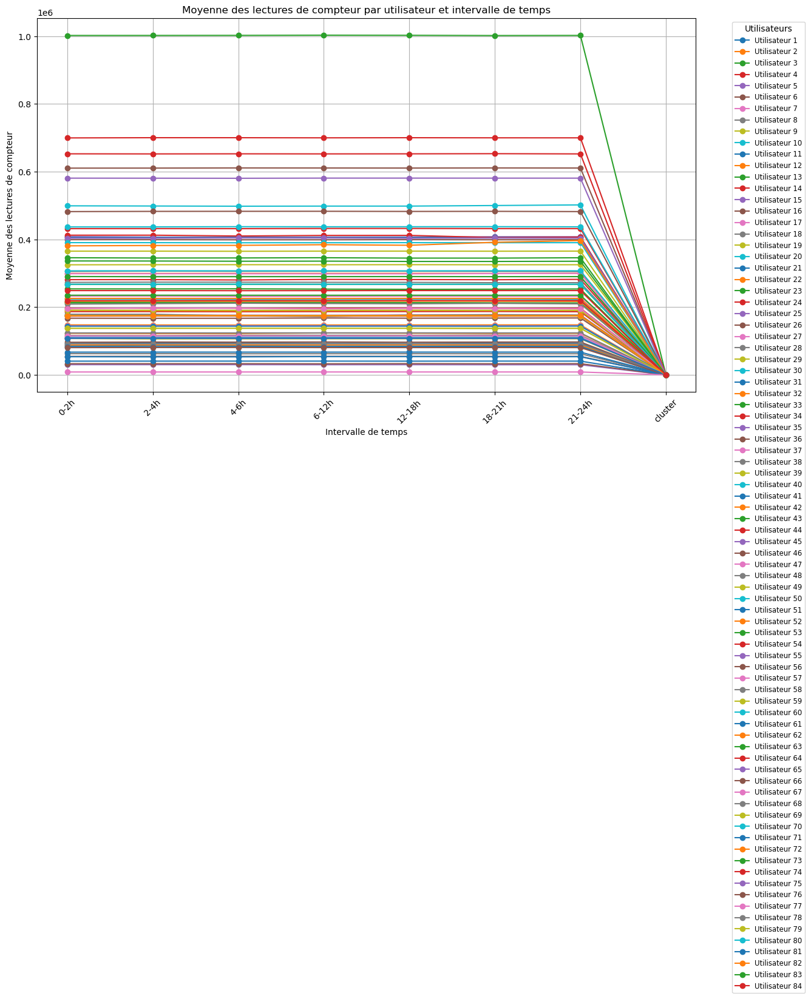

In [90]:
# Supposons que vous avez déjà `aggregated_df` avec les moyennes de meter.reading
# Vérifiez que votre DataFrame est correctement formaté
print(aggregated_df)

# Configuration de la figure
plt.figure(figsize=(14, 8))

# Tracer chaque utilisateur avec une couleur différente
for user_number in aggregated_df.index:
    plt.plot(aggregated_df.columns, aggregated_df.loc[user_number], marker='o', label=f'Utilisateur {user_number}')

# Ajouter les étiquettes et le titre
plt.title('Moyenne des lectures de compteur par utilisateur et intervalle de temps')
plt.xlabel('Intervalle de temps')
plt.ylabel('Moyenne des lectures de compteur')
plt.xticks(rotation=45)  # Faire pivoter les étiquettes sur l'axe x pour une meilleure lisibilité
plt.legend(title='Utilisateurs', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')
plt.grid(True)

# Afficher le graphique
plt.tight_layout()
plt.show()

In [93]:
# Étape 3 : Agrégation des données
# Calculer la moyenne des lectures de compteur par utilisateur et par intervalle de temps
aggregated_df_Diff = df_with_numbers.groupby(['user_number', 'time_interval'])['diff'].mean().unstack(fill_value=0)

# Afficher le DataFrame agrégé
print("DataFrame agrégé Diff :")

DataFrame agrégé Diff :


C:\Users\MSI\AppData\Local\Temp\ipykernel_12860\589037216.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  aggregated_df_Diff = df_with_numbers.groupby(['user_number', 'time_interval'])['diff'].mean().unstack(fill_value=0)


time_interval       0-2h       2-4h      4-6h      6-12h     12-18h  \
user_number                                                           
1               8.286682   7.620137  3.420188   7.626997  12.355786   
2               3.195745   0.756681  0.392157  22.432116  13.478728   
3              20.724138  14.870112  0.601399  19.521179  45.320222   
4               3.630986   1.173050  0.279267  13.211520   7.013909   
5               5.911628   3.699029  0.225000  15.533298  22.623165   
...                  ...        ...       ...        ...        ...   
80              5.783046   0.445087  0.900000  30.004255  21.017086   
81              0.032211   0.000000  0.001479   0.012469   0.126273   
82              6.095448   1.986880  1.398256   5.852941   6.519372   
83              7.818740   0.964451  0.894817  12.296465  14.663675   
84              7.064336   4.026499  3.774862   8.468173   7.921053   

time_interval     18-21h     21-24h  
user_number                          


C:\Users\MSI\AppData\Local\Temp\ipykernel_12860\3846580914.py:21: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


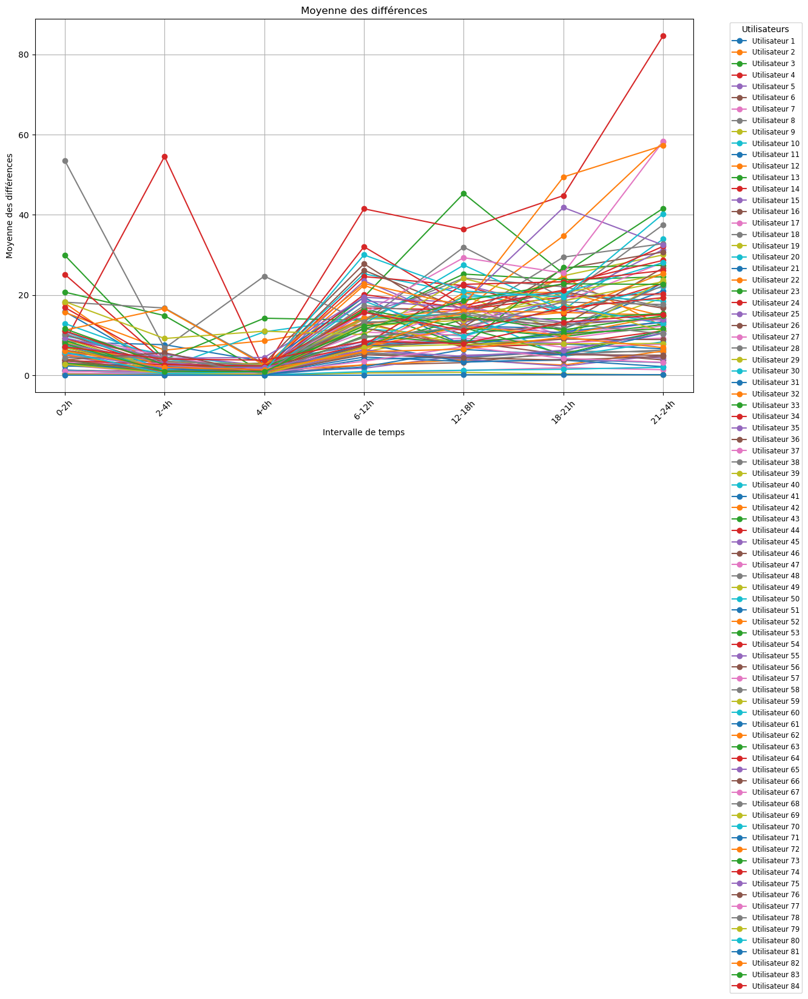

In [91]:
# Supposons que vous avez déjà `aggregated_df` avec les moyennes de meter.reading
# Vérifiez que votre DataFrame est correctement formaté
print(aggregated_df_Diff)

# Configuration de la figure
plt.figure(figsize=(14, 8))

# Tracer chaque utilisateur avec une couleur différente
for user_number in aggregated_df.index:
    plt.plot(aggregated_df_Diff.columns, aggregated_df_Diff.loc[user_number], marker='o', label=f'Utilisateur {user_number}')

# Ajouter les étiquettes et le titre
plt.title('Moyenne des différences')
plt.xlabel('Intervalle de temps')
plt.ylabel('Moyenne des différences')
plt.xticks(rotation=45)  # Faire pivoter les étiquettes sur l'axe x pour une meilleure lisibilité
plt.legend(title='Utilisateurs', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')
plt.grid(True)

# Afficher le graphique
plt.tight_layout()
plt.show()

In [125]:
df_with_numbers

,user.key,datetime,meter.reading,diff,Date,Time,user_number,hour,time_interval
0,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 01:19:43,68321.0,0,2016-03-01,01:19:43,1,1,0-2h
1,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 02:19:43,68321.0,0,2016-03-01,02:19:43,1,2,2-4h
2,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 03:19:43,68321.0,0,2016-03-01,03:19:43,1,3,2-4h
3,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 04:19:43,68321.0,0,2016-03-01,04:19:43,1,4,4-6h
4,1f8730a9-5d67-4895-9215-6e247087ea00,2016-03-01 05:39:54,68321.0,0,2016-03-01,05:39:54,1,5,4-6h
...,...,...,...,...,...,...,...,...,...
661197,890930db-249c-42b9-9210-573520bbaf35,2017-02-28 18:08:01,284336.0,0,2017-02-28,18:08:01,84,18,18-21h
661198,890930db-249c-42b9-9210-573520bbaf35,2017-02-28 19:08:06,284336.0,0,2017-02-28,19:08:06,84,19,18-21h
661199,890930db-249c-42b9-9210-573520bbaf35,2017-02-28 20:08:06,284363.0,27,2017-02-28,20:08:06,84,20,18-21h
661200,890930db-249c-42b9-9210-573520bbaf35,2017-02-28 21:08:06,284406.0,43,2017-02-28,21:08:06,84,21,21-24h


c:\Users\MSI\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
c:\Users\MSI\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
c:\Users\MSI\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
c:\Users\MSI\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with M

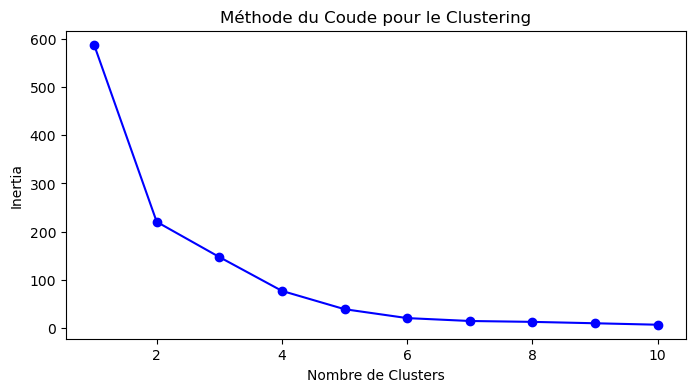

In [127]:
from sklearn.preprocessing import StandardScaler

# Supposons que `aggregated_df` contient les moyennes des lectures de compteur par utilisateur et par intervalle de temps

# Étape 1 : Prétraitement des données
# Normaliser les données
scaler = StandardScaler()
normalized_data = scaler.fit_transform(aggregated_df)

# Étape 2 : Déterminer le nombre de clusters
inertia = []
K = range(1, 11)
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(normalized_data)
    inertia.append(kmeans.inertia_)

# Tracer la méthode du coude
plt.figure(figsize=(8, 4))
plt.plot(K, inertia, 'bo-')
plt.xlabel('Nombre de Clusters')
plt.ylabel('Inertia')
plt.title('Méthode du Coude pour le Clustering')
plt.show()


In [ ]:
df_with_numbers = df_with_numbers.drop(columns=['cluster_y'])

In [137]:
df_with_numbers
aggregated_df

time_interval,0-2h,2-4h,4-6h,6-12h,12-18h,18-21h,21-24h,cluster
user_number,,,,,,,,
1,9.339429e+04,9.404092e+04,9.334419e+04,9.288926e+04,9.258867e+04,9.362960e+04,9.373105e+04,3
2,1.475378e+05,1.473633e+05,1.470288e+05,1.473244e+05,1.474212e+05,1.475189e+05,1.475966e+05,3
3,1.002284e+06,1.002369e+06,1.002589e+06,1.003136e+06,1.002812e+06,1.002098e+06,1.002435e+06,2
4,1.868638e+05,1.869756e+05,1.865898e+05,1.869528e+05,1.870816e+05,1.872200e+05,1.866324e+05,0
5,4.083059e+05,4.067537e+05,4.062393e+05,4.068016e+05,4.070430e+05,4.079639e+05,4.080462e+05,1
...,...,...,...,...,...,...,...,...
80,2.677294e+05,2.677735e+05,2.678823e+05,2.675481e+05,2.675129e+05,2.675592e+05,2.678409e+05,0
81,1.081714e+05,1.081689e+05,1.081686e+05,1.081687e+05,1.081670e+05,1.081746e+05,1.081714e+05,3
82,1.745637e+05,1.748069e+05,1.749437e+05,1.746902e+05,1.749768e+05,1.748583e+05,1.749157e+05,0


In [ ]:
# Étape 2 : Appliquer K-Means
kmeans = KMeans(n_clusters=4, random_state=42)
clusters = kmeans.fit_predict(normalized_data)

# Étape 3 : Ajouter les clusters à votre DataFrame agrégé
aggregated_df['cluster'] = clusters

# Étape 4 : Ajouter les clusters à df_with_numbers
# Répéter le label de cluster pour chaque utilisateur
df_with_numbers = df_with_numbers.merge(aggregated_df[['cluster']], on='user_number', how='left')

# Étape 5 : Afficher les informations par cluster
for cluster_number in range(4):  # Assurez-vous que vous avez 4 clusters
    user_info = df_with_numbers[df_with_numbers['cluster'] == cluster_number]
    #print(user_info[['user_number', 'meter.reading', 'time_interval']])  # Afficher les colonnes souhaitées#

# Optionnel : Sauvegarder le DataFrame mis à jour avec les clusters
df_with_numbers.to_csv('df_with_numbers_with_clusters.csv', index=False)

c:\Users\MSI\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


In [147]:
# Vérifier que les utilisateurs ne sont pas dans deux clusters différents
cluster_counts = aggregated_df['cluster'].value_counts()
print("Nombre d'utilisateurs par cluster :")
print(cluster_counts)

# Afficher les utilisateurs par cluster
for cluster in range(n_clusters):
    users_in_cluster = aggregated_df[aggregated_df['cluster'] == cluster].index.tolist()
    print(f"Utilisateurs dans le cluster {cluster}: {users_in_cluster}")

Nombre d'utilisateurs par cluster :
cluster
0    38
3    29
1    16
2     1
Name: count, dtype: int64
Utilisateurs dans le cluster 0: [4, 7, 13, 15, 18, 19, 20, 22, 23, 24, 25, 27, 28, 30, 32, 33, 36, 37, 43, 44, 47, 48, 49, 50, 52, 53, 57, 59, 63, 72, 73, 74, 78, 79, 80, 82, 83, 84]
Utilisateurs dans le cluster 1: [5, 10, 14, 16, 26, 31, 34, 39, 40, 46, 54, 55, 60, 62, 64, 65]
Utilisateurs dans le cluster 2: [3]
Utilisateurs dans le cluster 3: [1, 2, 6, 8, 9, 11, 12, 17, 21, 29, 35, 38, 41, 42, 45, 51, 56, 58, 61, 66, 67, 68, 69, 70, 71, 75, 76, 77, 81]
